# Plotting for results

This notebook produces all results plots.
It generates some gap in the data, fill with a method (filter, MDS ...), compute metrics and then makes all relevant plots

In [ ]:
%load_ext autoreload
%autoreload 2

In [ ]:
import altair as alt

In [ ]:
from meteo_imp.kalman.results import *
from meteo_imp.data import *
from meteo_imp.utils import *
import pandas as pd
import numpy as np
from pyprojroot import here
import torch
import seaborn as sns
import matplotlib.pyplot as plt
from IPython.display import SVG, Image

In [ ]:
import vl_convert as vlc
from pyprojroot import here
base_path_img = here("manuscript/Master Thesis - Meteorological time series imputation using Kalman filters - Simone Massaro/images2/")
base_path_tbl = here("manuscript/Master Thesis - Meteorological time series imputation using Kalman filters - Simone Massaro/tables2/")

base_path_img.mkdir(exist_ok=True), base_path_tbl.mkdir(exist_ok=True)

def save_plot(plot, path):
    png_data = vlc.vegalite_to_png(vl_spec=plot.to_json(), scale=3)
    with open(base_path_img / (path + ".png"), "wb") as f:
        f.write(png_data)

def show_plot(path): return Image(filename=base_path_img / (path + ".png"))

In [ ]:
reset_seed()
n_rep = 500

In [ ]:
hai = pd.read_parquet(hai_big_path).reindex(columns=var_type.categories)
hai_era = pd.read_parquet(hai_era_big_path)

In [ ]:
alt.data_transformers.disable_max_rows() # it is safe to do so as the plots are rendered using vl-convert and then showed as images

DataTransformerRegistry.enable('default')

## Comparison Imputation methods

In [ ]:
base_path_old = here("analysis/results/trained_14feb")
base_path = here("analysis/results/trained_21feb")

In [ ]:
def l_model(x, base_path=base_path): return torch.load(base_path / x)

In [ ]:
models_var_old = [
    {'var': 'TA',    'model': l_model("TA_specialized_gap_12-336_v2.pickle.pickle",base_path_old )},
    {'var': 'SW_IN', 'model': l_model("SW_IN_specialized_gap_12-336_v2.pickle.pickle",base_path_old )},
    {'var': 'LW_IN', 'model': l_model("LW_IN_specialized_gap_12-336_v1.pickle",base_path_old )},
    {'var': 'VPD',   'model': l_model("VPD_specialized_gap_12-336_v1.pickle",base_path_old )},
    {'var': 'WS',    'model': l_model("WS_specialized_gap_12-336_v3.pickle",base_path_old )},
    {'var': 'PA',    'model': l_model("PA_specialized_gap_12-336_v3.pickle",base_path_old )},
    {'var': 'P',     'model': l_model("P_specialized_gap_12-336_v1.pickle",base_path_old )},
    {'var': 'TS',    'model': l_model("TS_specialized_gap_12-336_v3.pickle",base_path_old )},
    {'var': 'SWC',   'model': l_model("SWC_specialized_gap_12-336_v3_4.pickle",base_path_old )},
]
models_var_old = pd.DataFrame.from_records(models_var_old)

In [ ]:
models_var = [
    {'var': 'TA',    'model': l_model("TA_specialized_gap_6-336_v3_0.pickle",base_path)},
    {'var': 'SW_IN', 'model': l_model("SW_IN_specialized_gap_6-336_v2_0.pickle",base_path)},
    {'var': 'LW_IN', 'model': l_model("LW_IN_specialized_gap_6-336_v1.pickle",base_path)},
    {'var': 'VPD',   'model': l_model("VPD_specialized_gap_6-336_v2_0.pickle",base_path)},
    {'var': 'WS',    'model': l_model("WS_specialized_gap_6-336_v1.pickle",base_path)},
    {'var': 'PA',    'model': l_model("PA_specialized_gap_6-336_v3_0.pickle",base_path)},
    {'var': 'P',     'model': l_model("1_gap_varying_6-336_v3.pickle",base_path)},
    {'var': 'TS',    'model': l_model("TS_specialized_gap_6-336_v2_0.pickle",base_path)},
    {'var': 'SWC',   'model': l_model("SWC_specialized_gap_6-336_v2_1.pickle",base_path)},
]
models_var = pd.DataFrame.from_records(models_var)

### Old vs new

In [ ]:
models_old_new = pd.concat([models_var.assign(version='new'), models_var_old.assign(version='old')])

In [ ]:
@cache_disk("new_old")
def get_new_old(n_rep=n_rep):
    
    kcomp_control = KalmanImpComparison(models_old_new, hai, hai_era, block_len=100+48*7)

    res = kcomp_control.compare(n_rep =n_rep, gap_len = [12, 24, 48, 48*7], var = list(hai.columns))
    
    return res

In [ ]:
res_old_new = get_new_old(30)

In [ ]:
p = plot_compare(res_old_new, 'version', scale_domain=["new", "old"])
save_plot(p, "old_new")
p

alt.VConcatChart(...)

In [ ]:
from functools import partial

In [ ]:
table_compare(res_old_new, 'version')

version                  old                 new                    
RMSE Standardized       mean       std      mean       std     diff.
Variable Gap [$h$]                                                  
TA       6.0        0.065378  0.034118  0.053102  0.030440 -0.012275
         12.0       0.089724  0.049703  0.081287  0.048136 -0.008436
         24.0       0.127353  0.083480  0.116559  0.071883 -0.010795
         168.0      0.138959  0.060207  0.135035  0.058048 -0.003924
SW_IN    6.0        0.219956  0.203877  0.203373  0.173751 -0.016584
         12.0       0.275117  0.177155  0.263598  0.155561 -0.011519
         24.0       0.268877  0.138038  0.268416  0.137251 -0.000461
         168.0      0.264838  0.088349  0.264030  0.084793 -0.000808
LW_IN    6.0        0.280027  0.193981  0.280712  0.203033  0.000684
         12.0       0.321675  0.185618  0.334790  0.195499  0.013116
         24.0       0.365977  0.274446  0.356476  0.234537 -0.009501
         168.0      0.440799  0.172347  0.432702  0.166955 -0.008097
VPD      6.0        0.163775  0.140889  0.119206  0.132791 -0.044569
         12.0       0.218189  0.166097  0.182499  0.127480 -0.035690
         24.0       0.226380  0.126265  0.209695  0.106824 -0.016685
         168.0      0.254821  0.132731  0.242704  0.132320 -0.012116
WS       6.0        0.386589  0.199048  0.407558  0.202452  0.020969
         12.0       0.417816  0.125848  0.418406  0.129669  0.000591
         24.0       0.542897  0.315976  0.564967  0.341026  0.022070
         168.0      0.545839  0.248422  0.554766  0.262952  0.008927
PA       6.0        0.061107  0.062039  0.057638  0.044863 -0.003469
         12.0       0.072143  0.048526  0.073675  0.043362  0.001532
         24.0       0.077781  0.064367  0.086437  0.069553  0.008656
         168.0      0.073142  0.020995  0.075264  0.025069  0.002122
P        6.0        0.394970  0.500444  0.471042  0.503129  0.076072
         12.0       0.551082  1.226294  0.802319  2.101092  0.251237
         24.0       0.449901  0.450820  0.613983  0.438106  0.164082
         168.0      0.815211  0.774186  1.007419  0.723227  0.192207
SWC      6.0        0.064453  0.042231  0.082461  0.054295  0.018008
         12.0       0.050170  0.021756  0.086962  0.042916  0.036791
         24.0       0.097666  0.074399  0.141850  0.087580  0.044185
         168.0      0.157057  0.088799  0.505197  0.238485  0.348140
TS       6.0        0.075355  0.071843  0.088789  0.083617  0.013433
         12.0       0.093737  0.064550  0.132530  0.097411  0.038794
         24.0       0.161774  0.131750  0.197921  0.104006  0.036147
         168.0      0.230206  0.086792  0.286576  0.116493  0.056370

The gap is a only in the variable that is gap-filled

In [ ]:
hai.columns

Index(['TA', 'SW_IN', 'LW_IN', 'VPD', 'WS', 'PA', 'P', 'SWC', 'TS'], dtype='object')

In [ ]:
@cache_disk(cache_dir / "the_results")
def get_the_results(n_rep=20):
    comp_Av = ImpComparison(models = models_var, df = hai, control = hai_era, block_len = 446, time_series=False)
    results_Av = comp_Av.compare(gap_len = [12,24, 48, 336], var=list(hai.columns), n_rep=n_rep) 
    return results_Av

results_Av = get_the_results(n_rep)

### Percentage improvement

In [ ]:
all_res = results_Av.query('var != "P"').groupby(['method']).agg({'rmse_stand': 'mean'}).T

In [ ]:
all_res

method,KalmanFilter,ERA,MDS
rmse_stand,0.204628,0.307361,0.482837


percentage of improvement across all variables

In [ ]:
(all_res["ERA"] - all_res["KalmanFilter"]) / all_res["ERA"] * 100 

rmse_stand    33.42398
dtype: float64

In [ ]:
(all_res["MDS"] - all_res["KalmanFilter"]) / all_res["MDS"] * 100 

rmse_stand    57.619542
dtype: float64

In [ ]:
res_var = results_Av.groupby(['method', 'var']).agg({'rmse_stand': 'mean'}) 

In [ ]:
res_var = res_var.reset_index().pivot(columns='method', values='rmse_stand', index='var')

In [ ]:
pd.DataFrame({'ERA': (res_var["ERA"] - res_var["KalmanFilter"]) / res_var["ERA"] * 100, 'MDS': (res_var["MDS"] - res_var["KalmanFilter"]) / res_var["MDS"] * 100 })

,ERA,MDS
var,,
TA,54.540802,77.713711
SW_IN,12.004508,35.516142
LW_IN,5.166063,52.289627
VPD,44.402821,65.407769
WS,21.064305,40.321732
PA,28.784191,90.751559
P,-18.544370,-22.084360
SWC,NaN,41.543006
TS,NaN,25.772326


In [ ]:
res_var2 = results_Av.groupby(['method', 'var', 'gap_len']).agg({'rmse_stand': 'mean'}) 

In [ ]:
res_var2 = res_var2.reset_index().pivot(columns='method', values='rmse_stand', index=['var', 'gap_len'])

In [ ]:
pd.DataFrame({'ERA': (res_var2["ERA"] - res_var2["KalmanFilter"]) / res_var2["ERA"] * 100, 'MDS': (res_var2["MDS"] - res_var2["KalmanFilter"]) / res_var2["MDS"] * 100 })

ERA        MDS
var   gap_len                      
TA    6.0      69.897582  85.052698
      12.0     58.766166  79.376385
      24.0     51.538443  75.395970
      168.0    41.823614  73.000401
SW_IN 6.0       9.519984  29.746651
      12.0     11.165399  30.639223
      24.0     14.232051  34.811941
      168.0    12.305658  42.651906
LW_IN 6.0      21.023524  59.136518
      12.0      9.110040  52.211404
      24.0     -3.553292  50.720632
      168.0    -4.260023  48.223005
VPD   6.0      66.980942  79.449579
      12.0     47.785633  69.081018
      24.0     33.663749  56.728120
      168.0    32.272332  57.702579
WS    6.0      32.402977  45.724043
      12.0     25.209162  43.275430
      24.0     15.543672  37.142502
      168.0    12.735569  36.436106
PA    6.0      39.823585  91.511486
      12.0     30.995845  90.532461
      24.0     24.727301  89.319180
      168.0    20.691181  91.421434
P     6.0     -18.485009 -13.917879
      12.0    -28.935358 -37.127331
      24.0    -24.423076 -29.998707
      168.0    -7.725322 -11.587796
SWC   6.0            NaN  61.302664
      12.0           NaN  47.976950
      24.0           NaN  42.535719
      168.0          NaN  23.301469
TS    6.0            NaN  64.264901
      12.0           NaN  46.699870
      24.0           NaN  27.050291
      168.0          NaN -15.268479

var
TA       77.713711
SW_IN    35.516142
LW_IN    52.289627
VPD      65.407769
WS       40.321732
PA       90.751559
P       -22.084360
SWC      41.543006
TS       25.772326
dtype: float64

### Main plot

In [ ]:
from itertools import product
import altair as alt

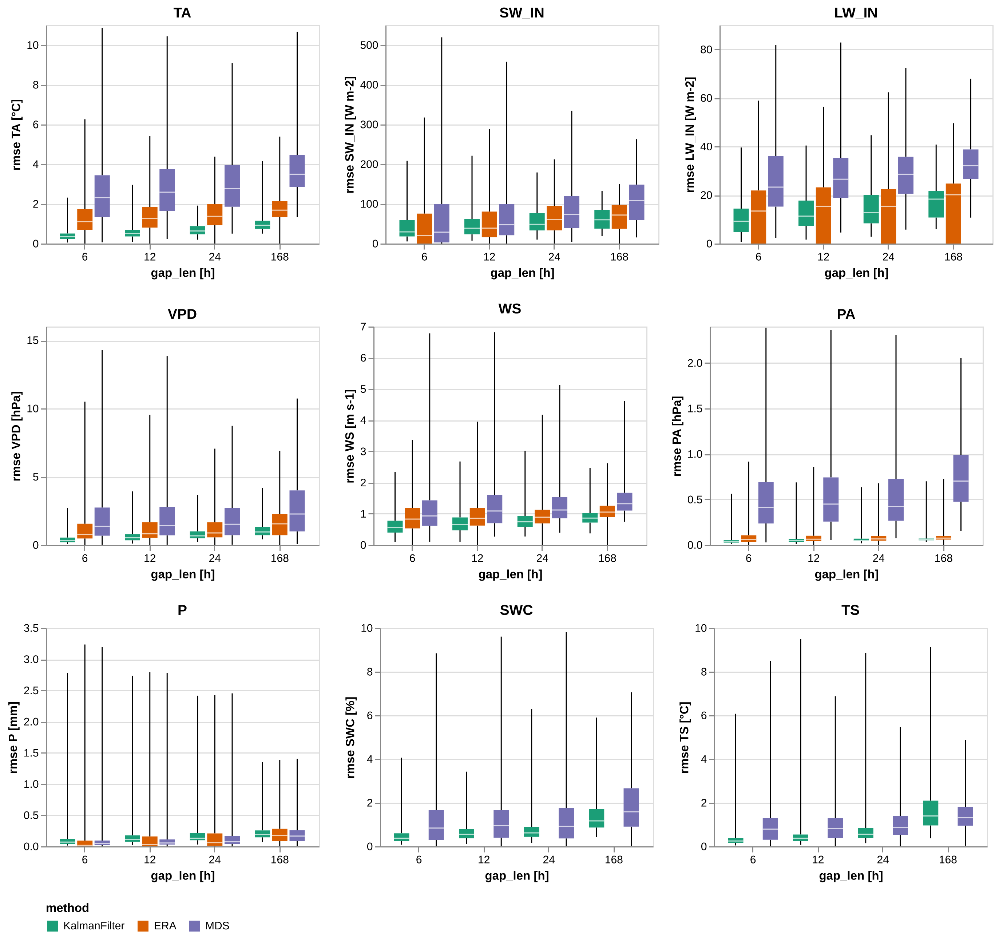

In [ ]:
p = the_plot(results_Av)
save_plot(p, "the_plot")
show_plot("the_plot")

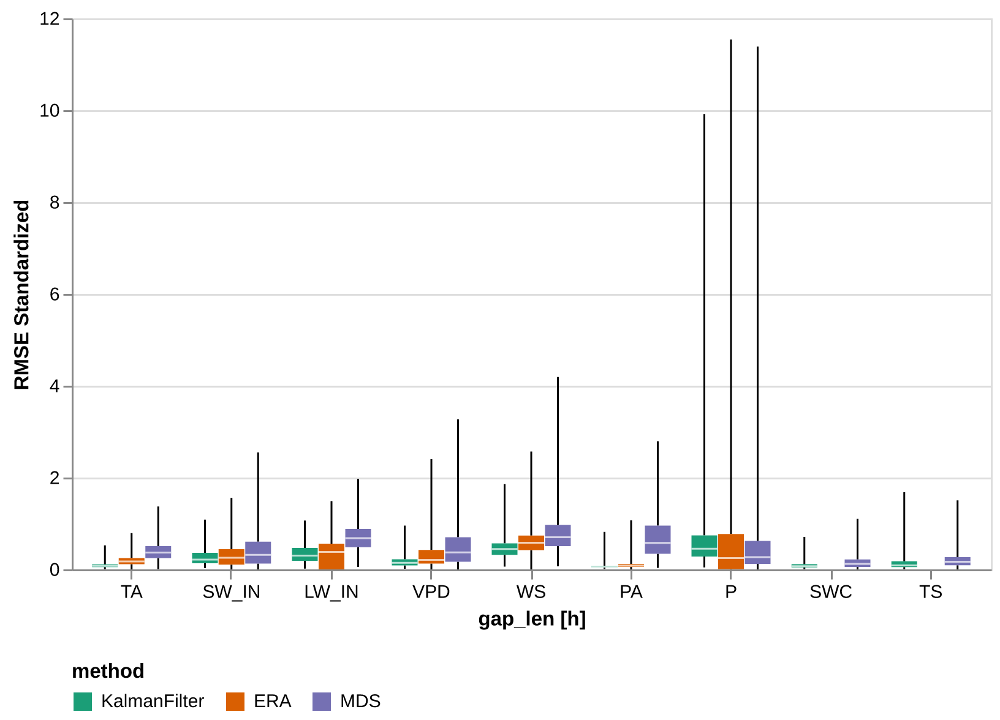

In [ ]:
p = the_plot_stand(results_Av)
save_plot(p, "the_plot_stand")
show_plot("the_plot_stand")

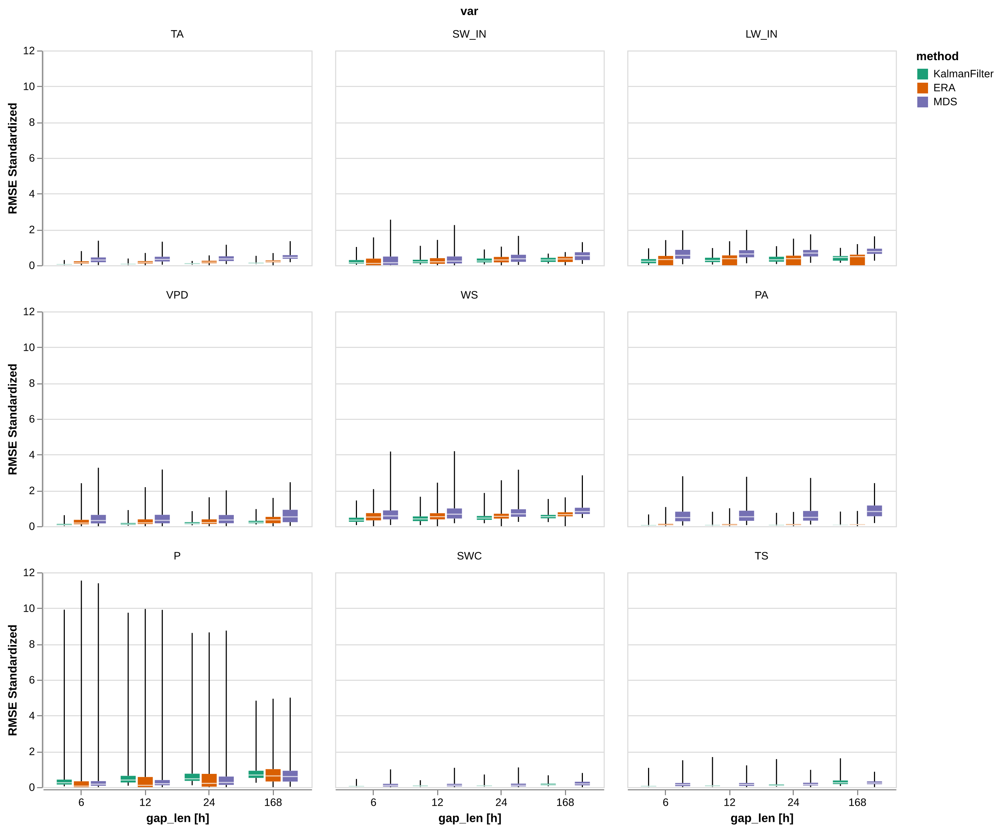

In [ ]:
p = the_plot_stand2(results_Av)
save_plot(p, "the_plot_stand2")
show_plot("the_plot_stand2")

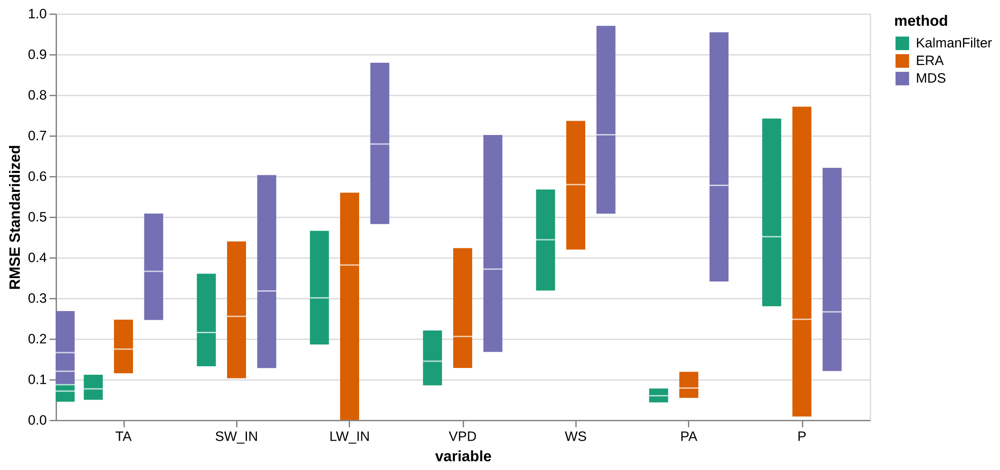

In [ ]:
p = the_plot_stand3(results_Av)
save_plot(p, "the_plot_stand3")
show_plot("the_plot_stand3")

### Table 

In [ ]:
t = the_table(results_Av)
the_table_latex(t, base_path_tbl / "the_table.tex", label="the_table",
                caption="RMSE Comparison imputation methods. The best method for each gap length is highligthed in bold")
t

KalmanFilter                   ERA                    MDS  \
RMSE                       mean        std       mean        std        mean   
Variable Gap [$h$]                                                             
TA       6.0           0.405453   0.258301   1.346910   0.997843    2.712546   
         12.0          0.606836   0.400849   1.471695   0.900611    2.942435   
         24.0          0.741275   0.368468   1.529614   0.800256    3.012819   
         168.0         1.020608   0.444591   1.754334   0.643160    3.780087   
SW_IN    6.0          44.636609  40.464629  49.333113  66.241975   63.536627   
         12.0         48.155186  33.868178  54.207691  49.769296   69.427115   
         24.0         56.564277  30.042752  65.950367  40.930505   86.770917   
         168.0        61.582820  25.740161  70.224393  34.883199  107.384249   
LW_IN    6.0          10.902409   7.736087  13.804628  12.987987   26.680077   
         12.0         13.421656   7.734502  14.766929  12.584725   28.085478   
         24.0         14.593819   7.840046  14.093052  12.227900   29.614461   
         168.0        17.062880   6.425136  16.365697  11.129569   32.954558   
VPD      6.0           0.428187   0.363168   1.296787   1.547397    2.083592   
         12.0          0.660623   0.504761   1.265213   1.288794    2.136626   
         24.0          0.827563   0.501975   1.247527   1.032319    1.912472   
         168.0         1.125680   0.633392   1.662069   1.127314    2.661345   
WS       6.0           0.616774   0.316972   0.912428   0.508295    1.136367   
         12.0          0.715412   0.350974   0.956550   0.524247    1.261203   
         24.0          0.801851   0.343378   0.949427   0.446912    1.275665   
         168.0         0.950211   0.363124   1.088887   0.348541    1.494891   
PA       6.0           0.045046   0.034294   0.074856   0.061726    0.530665   
         12.0          0.053359   0.041613   0.077328   0.058476    0.563603   
         24.0          0.059481   0.038666   0.079021   0.051491    0.556899   
         168.0         0.066325   0.047544   0.083628   0.053654    0.773143   
P        6.0           0.134093   0.274033   0.113173   0.315504    0.117710   
         12.0          0.178871   0.295419   0.138729   0.297227    0.130442   
         24.0          0.206231   0.253588   0.165750   0.288432    0.158641   
         168.0         0.239885   0.173820   0.222682   0.201782    0.214975   
SWC      6.0           0.508379   0.487342        NaN        NaN    1.313730   
         12.0          0.664855   0.471849        NaN        NaN    1.278001   
         24.0          0.779066   0.640996        NaN        NaN    1.355740   
         168.0         1.493784   0.947799        NaN        NaN    1.947605   
TS       6.0           0.341080   0.431992        NaN        NaN    0.954469   
         12.0          0.534363   0.783787        NaN        NaN    1.002555   
         24.0          0.786670   0.851931        NaN        NaN    1.078373   
         168.0         1.659875   1.077782        NaN        NaN    1.440008   

                               
RMSE                      std  
Variable Gap [$h$]             
TA       6.0         1.896914  
         12.0        1.748131  
         24.0        1.611311  
         168.0       1.315472  
SW_IN    6.0        85.401585  
         12.0       68.936352  
         24.0       59.603564  
         168.0      53.606111  
LW_IN    6.0        15.022366  
         12.0       13.457335  
         24.0       12.416763  
         168.0       8.833972  
VPD      6.0         2.149288  
         12.0        2.095549  
         24.0        1.605013  
         168.0       1.965431  
WS       6.0         0.783146  
         12.0        0.796744  
         24.0        0.608630  
         168.0       0.615371  
PA       6.0         0.441476  
         12.0        0.427426  
         24.0        0.404451  
         168.0       0.384029  
P        6.0         0.305539  
  

In [ ]:
t = the_table(results_Av, 'rmse_stand')
the_table_latex(t, base_path_tbl / "the_table_stand.tex", stand = True, label="the_table_stand", 
                caption = "Comparison of imputation methods using Standardized RMSE. The best method for each gap length is highligthed in bold")
t

KalmanFilter                 ERA                 MDS  \
RMSE                       mean       std      mean       std      mean   
Variable Gap [$h$]                                                        
TA       6.0           0.051164  0.032595  0.169965  0.125917  0.342294   
         12.0          0.076576  0.050583  0.185712  0.113647  0.371303   
         24.0          0.093541  0.046497  0.193021  0.100984  0.380185   
         168.0         0.128790  0.056103  0.221378  0.081160  0.477006   
SW_IN    6.0           0.218804  0.198354  0.241826  0.324711  0.311450   
         12.0          0.236052  0.166018  0.265721  0.243964  0.340325   
         24.0          0.277272  0.147267  0.323282  0.200637  0.425342   
         168.0         0.301873  0.126176  0.344233  0.170994  0.526387   
LW_IN    6.0           0.259855  0.184387  0.329028  0.309564  0.635910   
         12.0          0.319900  0.184349  0.351964  0.299952  0.669407   
         24.0          0.347838  0.186865  0.335903  0.291448  0.705850   
         168.0         0.406688  0.153141  0.390071  0.265269  0.785460   
VPD      6.0           0.098019  0.083135  0.296855  0.354224  0.476967   
         12.0          0.151227  0.115548  0.289627  0.295025  0.489108   
         24.0          0.189442  0.114910  0.285579  0.236314  0.437795   
         168.0         0.257686  0.144994  0.380474  0.258060  0.609224   
WS       6.0           0.379454  0.195008  0.561347  0.312715  0.699120   
         12.0          0.440138  0.215927  0.588492  0.322529  0.775922   
         24.0          0.493318  0.211254  0.584110  0.274951  0.784819   
         168.0         0.584592  0.223403  0.669909  0.214431  0.919692   
PA       6.0           0.052675  0.040103  0.087534  0.072180  0.620545   
         12.0          0.062397  0.048661  0.090425  0.068381  0.659061   
         24.0          0.069556  0.045215  0.092405  0.060212  0.651223   
         168.0         0.077558  0.055597  0.097793  0.062741  0.904092   
P        6.0           0.478431  0.977725  0.403790  1.125691  0.419979   
         12.0          0.638197  1.054031  0.494974  1.060481  0.465404   
         24.0          0.735816  0.904779  0.591382  1.029100  0.566018   
         168.0         0.855891  0.620173  0.794512  0.719941  0.767011   
SWC      6.0           0.057037  0.054677       NaN       NaN  0.147393   
         12.0          0.074593  0.052939       NaN       NaN  0.143384   
         24.0          0.087407  0.071916       NaN       NaN  0.152106   
         168.0         0.167594  0.106338       NaN       NaN  0.218510   
TS       6.0           0.060276  0.076342       NaN       NaN  0.168674   
         12.0          0.094433  0.138512       NaN       NaN  0.177172   
         24.0          0.139021  0.150554       NaN       NaN  0.190571   
         168.0         0.293335  0.190466       NaN       NaN  0.254479   

                              
RMSE                     std  
Variable Gap [$h$]            
TA       6.0        0.239370  
         12.0       0.220595  
         24.0       0.203330  
         168.0      0.165998  
SW_IN    6.0        0.418630  
         12.0       0.337919  
         24.0       0.292171  
         168.0      0.262772  
LW_IN    6.0        0.358053  
         12.0       0.320751  
         24.0       0.295949  
         168.0      0.210555  
VPD      6.0        0.492006  
         12.0       0.479704  
         24.0       0.367413  
         168.0      0.449918  
WS       6.0        0.481810  
         12.0       0.490176  
         24.0       0.374443  
         168.0      0.378591  
PA       6.0        0.516250  
         12.0       0.499820  
         24.0       0.472953  
         168.0      0.449073  
P        6.0        1.090136  
         12.0       1.003928  
         24.0       0.946414  
         168.0      0.704660  
SWC      6.0        0.174667  
         12.0       0.148434  
         24.0       0.165171  
         168.0      0.166977  
TS      

### Timeseries

In [ ]:
@cache_disk(cache_dir / "the_results_ts")
def get_the_results_ts():
    comp_Av = ImpComparison(models = models_var, df = hai, control = hai_era, block_len = 446, time_series=True, rmse=False)
    results_Av = comp_Av.compare(gap_len = [12,24, 336], var=list(hai.columns), n_rep=4) 
    return results_Av

results_ts = get_the_results_ts()

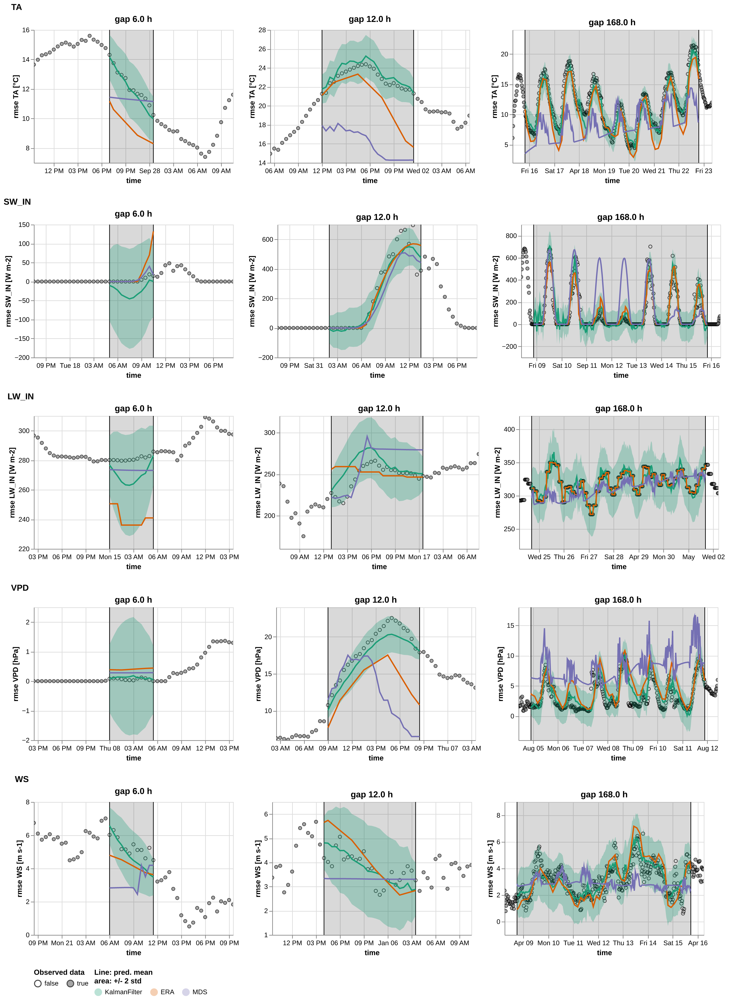

In [ ]:
ts = plot_timeseries(results_ts.query("var in ['TA', 'SW_IN', 'LW_IN', 'VPD', 'WS']"), idx_rep=0)
save_plot(ts, "timeseries_1")
show_plot("timeseries_1")

CPU times: user 4.29 s, sys: 0 ns, total: 4.29 s
Wall time: 4.32 s
CPU times: user 38.1 s, sys: 12.9 s, total: 51 s
Wall time: 50.4 s


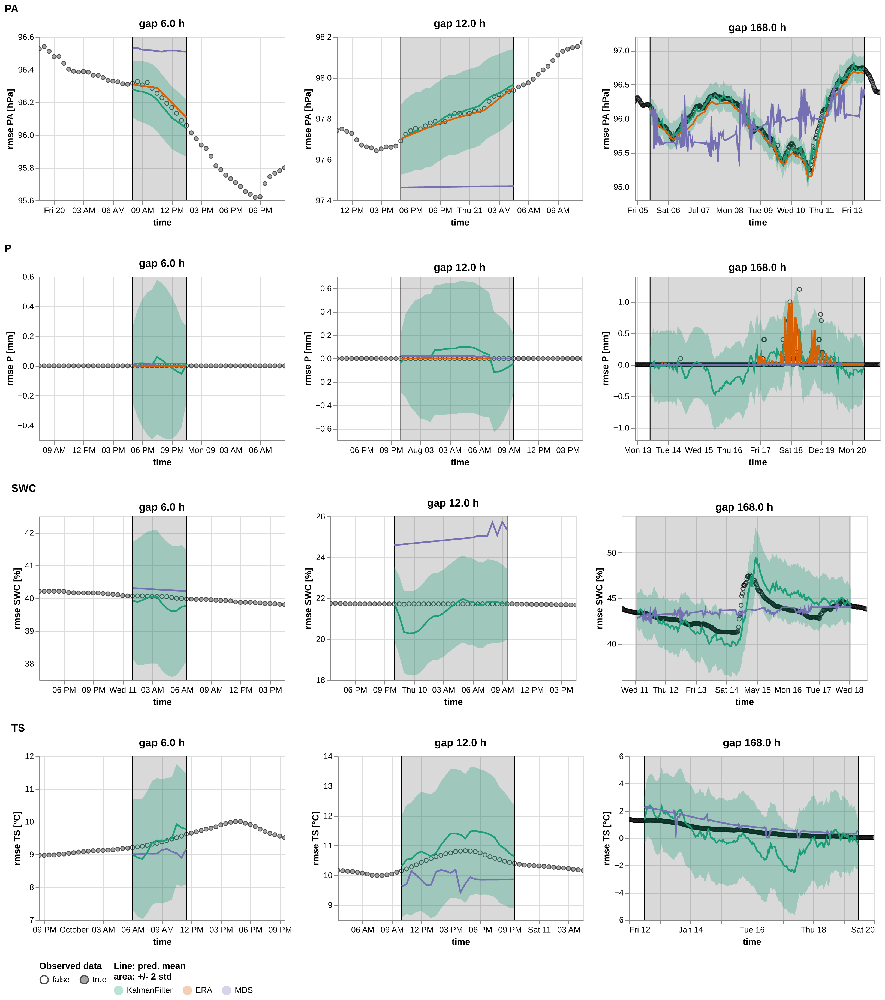

In [ ]:
%time ts = plot_timeseries(results_ts.query("var in ['PA', 'P', 'TS', 'SWC']"), idx_rep=0)
%time save_plot(ts, "timeseries_2")
show_plot("timeseries_2")

In [ ]:
from tqdm.auto import tqdm

In [ ]:
@cache_disk(cache_dir / "ts_plot")
def plot_additional_ts():
    for idx in tqdm(results_ts.idx_rep.unique()):
        if idx == 0: continue # skip first plot as is done above
        ts1 = plot_timeseries(results_ts.query("var in ['TA', 'SW_IN', 'LW_IN', 'VPD', 'WS']"), idx_rep=idx)
        save_plot(ts1, f"timeseries_1_{idx}")
        ts2 = plot_timeseries(results_ts.query("var in ['PA', 'P', 'TS', 'SWC']"), idx_rep=idx)
        save_plot(ts2, f"timeseries_2_{idx}")        

In [ ]:
plot_additional_ts()

## Kalman Filter analysis

### Gap len

In [ ]:
@cache_disk("gap_len")
def get_g_len(n_rep=n_rep):
    return KalmanImpComparison(models_var, hai, hai_era, block_len=48*7+100).compare(gap_len = [2,6,12,24,48,48*2, 48*3, 48*7], var=list(hai.columns), n_rep=n_rep)

In [ ]:
gap_len = get_g_len(n_rep)

In [ ]:
p = plot_gap_len(gap_len, hai, hai_era)
save_plot(p, "gap_len")
p

alt.VConcatChart(...)

In [ ]:
t = table_gap_len(gap_len)
table_gap_len_latex(t, base_path_tbl / "gap_len.tex", label="gap_len",
                caption="RMSE Comparison Kalman filter for different gap lengths")
t

1          3          6         12         24  \
Variable RMSE                                                          
TA       mean   0.194354   0.286686   0.439898   0.627774   0.825657   
         std    0.170168   0.191621   0.319131   0.394308   0.441307   
SW_IN    mean  27.869381  37.736508  44.485780  50.089934  57.305556   
         std   40.674507  38.361149  38.011124  34.547960  29.069868   
LW_IN    mean   5.627963   7.948118  11.455198  13.292480  15.916159   
         std    6.612598   7.564646   8.072892   8.415339   8.774831   
VPD      mean   0.180114   0.319469   0.501255   0.688441   0.946403   
         std    0.204093   0.358347   0.484957   0.608219   0.686398   
WS       mean   0.361465   0.494700   0.616030   0.770239   0.830321   
         std    0.323714   0.301577   0.373032   0.435992   0.459242   
PA       mean   0.022211   0.033831   0.048117   0.052795   0.059260   
         std    0.018450   0.022981   0.047558   0.030419   0.039748   
P        mean   0.091639   0.165085   0.116147   0.200376   0.185713   
         std    0.273413   0.538698   0.157560   0.343884   0.203738   
SWC      mean   0.186740   0.332085   0.452526   0.617151   0.751877   
         std    0.208227   0.293192   0.294969   0.432676   0.579932   
TS       mean   0.151836   0.231586   0.381999   0.590929   0.676975   
         std    0.154047   0.206538   0.427692   0.828540   0.589255   

                      48         72        168  
Variable RMSE                                   
TA       mean   0.903880   0.938702   0.986020  
         std    0.449117   0.408243   0.347736  
SW_IN    mean  58.099263  58.937990  59.044984  
         std   25.844578  26.383210  25.259337  
LW_IN    mean  17.051384  16.284372  17.491457  
         std    8.078440   7.010162   7.286120  
VPD      mean   0.957061   1.061895   1.104943  
         std    0.624435   0.609132   0.602005  
WS       mean   0.905966   0.916504   0.914477  
         std    0.397321   0.339037   0.300834  
PA       mean   0.067833   0.065873   0.069754  
         std    0.063229   0.050773   0.050060  
P        mean   0.208122   0.215432   0.238309  
         std    0.190703   0.186401   0.150946  
SWC      mean   0.909684   0.959049   1.460350  
         std    0.666566   0.676641   0.900856  
TS       mean   0.994570   1.357970   1.663379  
         std    0.815527   1.027602   1.059882

In [ ]:
g_len_agg = gap_len.groupby('gap_len').agg({'rmse_stand': 'mean'})
(g_len_agg.iloc[0])/g_len_agg.iloc[-1]

rmse_stand    0.316083
dtype: float64

In [ ]:
g_len_agg = gap_len.groupby(['gap_len', 'var']).agg({'rmse_stand': 'mean'})
(g_len_agg.loc[1.])/g_len_agg.loc[168.]

,rmse_stand
var,
TA,0.197110
SW_IN,0.472003
LW_IN,0.321755
VPD,0.163008
WS,0.395269
PA,0.318417
P,0.384538
SWC,0.127873
TS,0.091282


In [ ]:
g_len_agg

rmse_stand
gap_len var              
1.0     TA       0.024525
        SW_IN    0.136613
        LW_IN    0.134140
        VPD      0.041231
        WS       0.222382
...                   ...
168.0   WS       0.562608
        PA       0.081568
        P        0.850266
        SWC      0.163843
        TS       0.293954

[72 rows x 1 columns]

In [ ]:
g_len_agg_std = gap_len.groupby('gap_len').agg({'rmse_stand': 'std'})
(g_len_agg_std.iloc[0])/g_len_agg_std.iloc[-1]

rmse_stand    1.125078
dtype: float64

<AxesSubplot: xlabel='gap_len'>

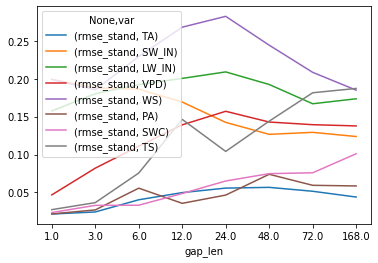

In [ ]:
gap_len.groupby(['gap_len', 'var']).agg({'rmse_stand': 'std'}).unstack("var").drop(columns=('rmse_stand', "P")).plot()

In [ ]:
# with open(base_path_tbl / "gap_len.tex") as f:
    # print(f.readlines())

### Control

In [ ]:
models_nc = pd.DataFrame({'model': [ l_model("1_gap_varying_336_no_control_v1.pickle"), l_model("1_gap_varying_6-336_v3.pickle")],
                          'type':   [ 'No Control',                                       'Use Control'                         ]})                                        

In [ ]:
@cache_disk("use_control")
def get_control(n_rep=n_rep):
    
    kcomp_control = KalmanImpComparison(models_nc, hai, hai_era, block_len=100+48*7)

    k_results_control = kcomp_control.compare(n_rep =n_rep, gap_len = [12, 24, 48, 48*7], var = list(hai.columns))
    
    return k_results_control

In [ ]:
from time import sleep

In [ ]:
k_results_control = get_control(n_rep)

In [ ]:
k_results_control

,var,loss,likelihood,gap_len,gap_idx,type,rmse,rmse_stand
0,TA,-5.742477,2.142377,6.0,0,No Control,0.227680,0.028731
1,TA,-5.755538,2.148783,6.0,1,No Control,0.228037,0.028776
2,TA,-1.232816,2.132641,6.0,2,No Control,1.813357,0.228826
3,TA,-4.693027,2.118098,6.0,3,No Control,0.906512,0.114392
4,TA,-5.179578,2.151546,6.0,4,No Control,0.726325,0.091654
...,...,...,...,...,...,...,...,...
995,TS,115.193441,0.966260,168.0,495,Use Control,1.770984,0.312970
996,TS,82.913345,1.474181,168.0,496,Use Control,1.403469,0.248022
997,TS,93.694508,1.154413,168.0,497,Use Control,1.526679,0.269796
998,TS,118.712986,1.494637,168.0,498,Use Control,1.798757,0.317878


In [ ]:
p = plot_compare(k_results_control, 'type', scale_domain=["Use Control", "No Control"])
save_plot(p, "use_control")
p

alt.VConcatChart(...)

In [ ]:
from functools import partial

In [ ]:
t = table_compare(k_results_control, 'type')
table_compare_latex(t, base_path_tbl / "control.tex", label="control",
                caption="Comparison between generic model with control variable (Use Control) and generic model without control variable (No Control). 50 samples for each variable and each gap length. The best result for each for each gap length is highligthed in bold")
t

type               Use Control           No Control                    
RMSE Standardized         mean       std       mean       std     diff.
Variable Gap [$h$]                                                     
TA       6.0          0.092151  0.055814   0.094594  0.059489  0.002443
         12.0         0.118358  0.074072   0.160712  0.106870  0.042354
         24.0         0.146578  0.076799   0.232744  0.159137  0.086166
         168.0        0.174324  0.064495   0.294072  0.147849  0.119748
SW_IN    6.0          0.255795  0.164694   0.331166  0.270628  0.075371
         12.0         0.314755  0.164839   0.518890  0.319771  0.204135
         24.0         0.339310  0.128516   0.608981  0.277150  0.269671
         168.0        0.357922  0.103167   0.693166  0.248412  0.335244
LW_IN    6.0          0.299442  0.201432   0.330486  0.185322  0.031044
         12.0         0.367537  0.197000   0.485509  0.193452  0.117972
         24.0         0.400412  0.175611   0.561446  0.186706  0.161035
         168.0        0.466036  0.141424   0.666359  0.161485  0.200323
VPD      6.0          0.137863  0.104531   0.178626  0.139476  0.040762
         12.0         0.226616  0.183575   0.320797  0.262730  0.094181
         24.0         0.272840  0.206783   0.407586  0.296989  0.134746
         168.0        0.325113  0.154287   0.499408  0.252086  0.174294
WS       6.0          0.571539  0.523304   0.429625  0.262009 -0.141914
         12.0         0.660302  0.408751   0.680223  0.391765  0.019921
         24.0         0.676472  0.374177   0.767313  0.430367  0.090841
         168.0        0.781636  0.264823   0.888977  0.318094  0.107340
PA       6.0          0.099325  0.066109   0.144519  0.105120  0.045194
         12.0         0.116360  0.061026   0.338753  0.209793  0.222393
         24.0         0.136620  0.076087   0.562996  0.378688  0.426376
         168.0        0.158988  0.068315   0.879748  0.439831  0.720760
P        6.0          0.542198  0.990843   0.507613  0.973715 -0.034584
         12.0         0.627167  1.034936   0.605429  1.025064 -0.021738
         24.0         0.628179  0.575428   0.614481  0.583966 -0.013698
         168.0        0.880507  0.572737   0.860985  0.597007 -0.019522
SWC      6.0          0.152144  0.107350   0.151053  0.141370 -0.001092
         12.0         0.244768  0.154341   0.305445  0.233699  0.060678
         24.0         0.392553  0.222757   0.538003  0.337738  0.145450
         168.0        0.719138  0.314318   0.842404  0.431371  0.123267
TS       6.0          0.168111  0.114636   0.118928  0.076226 -0.049183
         12.0         0.226302  0.134730   0.203284  0.132946 -0.023019
         24.0         0.286258  0.152198   0.285367  0.174358 -0.000891
         168.0        0.362279  0.176402   0.359044  0.191313 -0.003235

### Gap in Other variables

In [ ]:
models_gap_single = pd.DataFrame.from_records([
    {'Gap':  'All variables', 'gap_single_var': False, 'model': l_model("all_varying_gap_varying_len_6-30_v3.pickle")},
    {'Gap':  'Only one var',  'gap_single_var': True,  'model': l_model("all_varying_gap_varying_len_6-30_v3.pickle")},
])

In [ ]:
@cache_disk("gap_single")
def get_gap_single(n_rep):
    kcomp_single = KalmanImpComparison(models_gap_single, hai, hai_era, block_len=130)

    return kcomp_single.compare(n_rep =n_rep, gap_len = [6, 12, 24, 30], var = list(hai.columns))

In [ ]:
res_single = get_gap_single(n_rep)

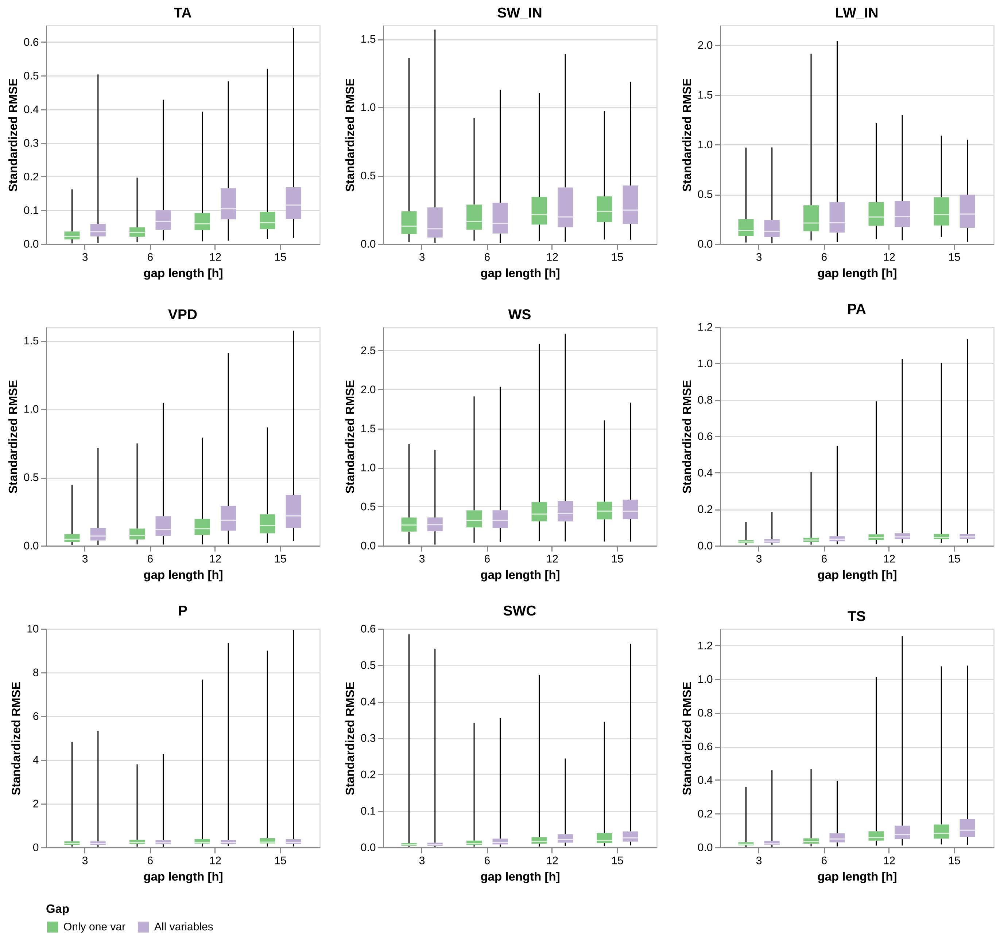

In [ ]:
p = plot_compare(res_single, "Gap", scale_domain=["Only one var", "All variables"])
save_plot(p, "gap_single_var")
show_plot("gap_single_var")

In [ ]:
t = table_compare(res_single, 'Gap')
table_compare_latex(t, base_path_tbl / "gap_single_var.tex")
t

Gap                Only one var           All variables                    
RMSE Standardized          mean       std          mean       std     diff.
Variable Gap [$h$]                                                         
TA       3.0           0.028752  0.023775      0.048794  0.047658  0.020042
         6.0           0.039721  0.028151      0.078262  0.052441  0.038541
         12.0          0.073367  0.049696      0.128982  0.082850  0.055615
         15.0          0.079064  0.056618      0.137702  0.091974  0.058638
SW_IN    3.0           0.199067  0.204647      0.202038  0.243918  0.002970
         6.0           0.221603  0.171424      0.227588  0.215318  0.005985
         12.0          0.259870  0.167001      0.284290  0.221368  0.024420
         15.0          0.276890  0.165700      0.306884  0.216898  0.029994
LW_IN    3.0           0.193706  0.169206      0.187165  0.174342 -0.006541
         6.0           0.276217  0.215933      0.287791  0.233930  0.011574
         12.0          0.325436  0.197345      0.327702  0.223464  0.002266
         15.0          0.336995  0.187926      0.344642  0.211682  0.007647
VPD      3.0           0.069788  0.070253      0.104548  0.105131  0.034761
         6.0           0.102529  0.096734      0.161396  0.140558  0.058866
         12.0          0.155312  0.115690      0.233406  0.192941  0.078093
         15.0          0.182637  0.133815      0.285944  0.227135  0.103307
WS       3.0           0.296947  0.179404      0.300916  0.181068  0.003969
         6.0           0.365649  0.202113      0.371086  0.211384  0.005437
         12.0          0.459507  0.242230      0.468449  0.248098  0.008941
         15.0          0.481226  0.229505      0.493956  0.249458  0.012730
PA       3.0           0.024047  0.016437      0.028570  0.020405  0.004523
         6.0           0.035908  0.027415      0.040551  0.032281  0.004643
         12.0          0.056931  0.073786      0.063504  0.090716  0.006573
         15.0          0.060922  0.090392      0.063848  0.099443  0.002926
P        3.0           0.289715  0.449747      0.282935  0.460265 -0.006780
         6.0           0.386047  0.524038      0.395858  0.592313  0.009811
         12.0          0.389821  0.550310      0.393073  0.640380  0.003252
         15.0          0.441714  0.675003      0.449441  0.767405  0.007728
SWC      3.0           0.012841  0.032253      0.013246  0.032911  0.000405
         6.0           0.017308  0.025438      0.021633  0.029543  0.004325
         12.0          0.025562  0.034110      0.031826  0.035939  0.006264
         15.0          0.033616  0.040491      0.040751  0.052965  0.007135
TS       3.0           0.023794  0.022665      0.030596  0.036472  0.006803
         6.0           0.046397  0.044287      0.065120  0.054703  0.018723
         12.0          0.082995  0.087660      0.105948  0.111548  0.022952
         15.0          0.113905  0.113941      0.137897  0.137050  0.023993

In [ ]:
res_singl_perc = res_single.groupby(['Gap', 'var', 'gap_len']).agg({'rmse_stand': 'mean'}).reset_index().pivot(columns = 'Gap', values='rmse_stand', index=['var', 'gap_len'])

In [ ]:
pd.DataFrame({'Only one var': (res_singl_perc["All variables"] - res_singl_perc["Only one var"]) / res_singl_perc["All variables"] * 100})

Only one var
var   gap_len              
TA    3.0         41.074754
      6.0         49.246103
      12.0        43.118382
      15.0        42.583240
SW_IN 3.0          1.470098
      6.0          2.629962
      12.0         8.589888
      15.0         9.773784
LW_IN 3.0         -3.494816
      6.0          4.021548
      12.0         0.691594
      15.0         2.218951
VPD   3.0         33.248307
      6.0         36.473299
      12.0        33.458173
      15.0        36.128386
WS    3.0          1.318961
      6.0          1.465055
      12.0         1.908674
      15.0         2.577221
PA    3.0         15.830854
      6.0         11.450242
      12.0        10.350316
      15.0         4.583045
P     3.0         -2.396308
      6.0          2.478452
      12.0         0.827264
      15.0         1.719407
SWC   3.0          3.057701
      6.0         19.993345
      12.0        19.682335
      15.0        17.509377
TS    3.0         22.233453
      6.0         28.751278
      12.0        21.663945
      15.0        17.398938

In [ ]:
res_singl_perc = res_single.groupby(['Gap', 'var']).agg({'rmse_stand': 'mean'}).reset_index().pivot(columns = 'Gap', values='rmse_stand', index=['var'])

In [ ]:
pd.DataFrame({'Only one var': (res_singl_perc["All variables"] - res_singl_perc["Only one var"]) / res_singl_perc["All variables"] * 100})

,Only one var
var,
TA,43.895946
SW_IN,6.207878
LW_IN,1.302744
VPD,35.022198
WS,1.901429
PA,9.500090
P,0.920959
SWC,16.871540
TS,21.342404


#### Old

In [ ]:
models_gap_single = pd.DataFrame.from_records([
    {'Gap':  'All variables',            'gap_single_var': False,  'model': l_model("All_gap_all_30_v1.pickle")  },
    {'Gap':  'Only one var | generic',   'gap_single_var': True,   'model': l_model("1_gap_varying_6-336_v3.pickle")  },
    {'Gap':  'Only one var | fine tuned','gap_single_var': True,   'model': l_model("1_gap_varying_tuned_6-30_v1.pickle")  }
])

In [ ]:
models_gap_single

,Gap,gap_single_var,model
0,All variables,False,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14"
1,Only one var | generic,True,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14"
2,Only one var | fine tuned,True,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14"


In [ ]:
@cache_disk("multi_gap")
def get_multi_gap(n_rep):
    kcomp_single = KalmanImpComparison(models_gap_single, hai, hai_era, block_len=130)

    return kcomp_single.compare(n_rep =n_rep, gap_len = [6, 12, 24, 30], var = list(hai.columns))

In [ ]:
k_results_single = get_multi_gap(n_rep)

In [ ]:
p = plot_compare(k_results_single, "Gap", scale_domain=["Only one var | fine tuned", "All variables", "Only one var | generic"])
save_plot(p, "gap_single_var")
p

alt.VConcatChart(...)

In [ ]:
t = table_gap_single(k_results_single, 'Gap')

Gap                All variables           Only one var | fine tuned  \
RMSE Standardized           mean       std                      mean   
Variable Gap [$h$]                                                     
TA       3.0            0.049142  0.039257                  0.045595   
         6.0            0.085800  0.056598                  0.067081   
         12.0           0.129696  0.090364                  0.098341   
         15.0           0.153630  0.095850                  0.118438   
SW_IN    3.0            0.206717  0.245049                  0.221908   
         6.0            0.257691  0.251566                  0.264143   
         12.0           0.288366  0.223825                  0.297092   
         15.0           0.309123  0.209180                  0.303225   
LW_IN    3.0            0.212700  0.194965                  0.220202   
         6.0            0.295903  0.207946                  0.302787   
         12.0           0.329140  0.229067                  0.372643   
         15.0           0.368030  0.252221                  0.378528   
VPD      3.0            0.090785  0.085969                  0.094815   
         6.0            0.164443  0.178822                  0.165489   
         12.0           0.238165  0.210442                  0.227116   
         15.0           0.265751  0.194125                  0.254020   
WS       3.0            0.311401  0.180608                  0.368460   
         6.0            0.402319  0.222570                  0.470035   
         12.0           0.477512  0.248510                  0.563454   
         15.0           0.492510  0.248111                  0.557210   
PA       3.0            0.035727  0.025997                  0.049086   
         6.0            0.050235  0.033742                  0.069733   
         12.0           0.069240  0.089894                  0.099269   
         15.0           0.069967  0.049172                  0.103711   
P        3.0            0.356274  0.560915                  0.356234   
         6.0            0.487482  0.699952                  0.577830   
         12.0           0.476344  0.871444                  0.623294   
         15.0           0.574291  1.002602                  0.727980   
SWC      3.0            0.016651  0.032101                  0.049046   
         6.0            0.027773  0.042202                  0.071308   
         12.0           0.043361  0.042561                  0.115449   
         15.0           0.049897  0.060443                  0.136793   
TS       3.0            0.047393  0.044903                  0.075194   
         6.0            0.084594  0.067924                  0.111484   
         12.0           0.163922  0.120530                  0.181564   
         15.0           0.187739  0.118778                  0.214730   

Gap                          Only one var | generic            
RMSE Standardized        std                   mean       std  
Variable Gap [$h$]                                             
TA       3.0        0.035802               0.061059  0.043398  
         6.0        0.052359               0.090001  0.060024  
         12.0       0.056265               0.121936  0.068288  
         15.0       0.082591               0.134282  0.075872  
SW_IN    3.0        0.201797               0.219821  0.205589  
         6.0        0.171401               0.268079  0.180135  
         12.0       0.158044               0.308926  0.170064  
         15.0       0.146023               0.311964  0.156975  
LW_IN    3.0        0.173989               0.216754  0.174078  
         6.0        0.199732               0.303669  0.199189  
         12.0       0.209362               0.366244  0.219349  
         15.0       0.193469               0.377619  0.208391  
VPD      3.0        0.070971               0.091829  0.065940  
         6.0        0.127027               0.158179  0.134617  
         12.0       0.147755               0.206106  0.145080  
         15.0       0.154401           

#### Time series

In [ ]:
# @cache_disk(cache_dir / "gap_single_ts")
def get_gap_single_ts():
    
    kcomp_single_ts = KalmanImpComparison(models_gap_single, hai, hai_era, block_len=130, rmse=False, time_series=True)

    return kcomp_single_ts.compare(n_rep =4, gap_len = [12, 24, 30], var = list(hai.columns))
    
g_single_ts = get_gap_single_ts()

  0%|          | 0/27 [00:00<?, ?it/s]

In [ ]:
g_single_ts.columns

Index(['var', 'loss', 'likelihood', 'gap_len', 'gap_idx', 'Gap',
       'gap_single_var', 'pred', 'targ'],
      dtype='object')

In [ ]:
plot_timeseries(g_single_ts.query("var in ['TA', 'SW_IN', 'LW_IN', 'VPD', 'WS']"), idx_rep=0, 
                scale_color=alt.Scale(scheme='accent', domain =["Only one var | fine tuned", "All variables", "Only one var | generic"]), ctx_len={6.: 50, 12.: 50, 15.: 50}, compare='Gap')

alt.VConcatChart(...)

In [ ]:
plot_timeseries(g_single_ts.query("var in ['PA', 'P', 'TS', 'SWC']"), idx_rep=0, 
                scale_color=alt.Scale(scheme='accent', domain =["Only one var | fine tuned", "All variables", "Only one var | generic"]), ctx_len={6.: 50, 12.: 50, 15.: 50}, compare='Gap')

alt.VConcatChart(...)

#### Extra


here I am testing by using the model tarined with gaps in only one variables on gaps of all variables

In [ ]:
models_gap_single2 = pd.DataFrame.from_records([
    {'Gap':  'all var test | all var train',  'gap_single_var': False,  'model': l_model("All_gap_all_30_v1.pickle")  },
    {'Gap':  'all var test | one var train',  'gap_single_var': False,  'model': l_model("1_gap_varying_tuned_6-30_v1.pickle")  },
    {'Gap':  'one var test | one var train',  'gap_single_var': True,   'model': l_model("1_gap_varying_tuned_6-30_v1.pickle")  }
])

In [ ]:
models_gap_single2

,Gap,gap_single_var,model
0,all var test | all var train,False,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14"
1,all var test | one var train,False,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14"
2,one var test | one var train,True,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14"


In [ ]:
@cache_disk("multi_gap2")
def get_multi_gap2(n_rep):
    kcomp_single = KalmanImpComparison(models_gap_single2, hai, hai_era, block_len=130)

    return kcomp_single.compare(n_rep =n_rep, gap_len = [6, 12, 24, 30], var = list(hai.columns))

In [ ]:
k_results_single2 = get_multi_gap2(25)

  0%|          | 0/36 [00:00<?, ?it/s]

In [ ]:
scale2 = ["all var test | one var train", "one var test | one var train", "all var test | all var train"]

In [ ]:
plot_compare(k_results_single2, "Gap", scale_domain=scale2)

alt.VConcatChart(...)

In [ ]:
def get_gap_single_ts2():
    
    kcomp_single_ts = KalmanImpComparison(models_gap_single2, hai, hai_era, block_len=130, rmse=False, time_series=True)

    return kcomp_single_ts.compare(n_rep =1, gap_len = [12, 24, 30], var = list(hai.columns))
    
g_single_ts2 = get_gap_single_ts2()

  0%|          | 0/27 [00:00<?, ?it/s]

In [ ]:
plot_timeseries(g_single_ts2.query("var in ['TA', 'SW_IN', 'LW_IN', 'VPD', 'WS']"), idx_rep=0, 
                scale_color=alt.Scale(scheme='accent', domain = scale2), ctx_len={6.: 50, 12.: 50, 15.: 50}, compare='Gap')

alt.VConcatChart(...)

In [ ]:
plot_timeseries(g_single_ts2.query("var in ['PA', 'P', 'TS', 'SWC']"), idx_rep=0, 
                scale_color=alt.Scale(scheme='accent', domain =scale2), ctx_len={6.: 50, 12.: 50, 15.: 50}, compare='Gap')

alt.VConcatChart(...)

#### Extra 3

comparing model trained on gaps with a variable number of variables missing

In [ ]:
models_gap_single3 = pd.DataFrame.from_records([
    {'Gap':  'all var test | all var train',  'gap_single_var': False,  'model': l_model("All_gap_all_30_v1.pickle")  },
    {'Gap':  'all var test | multi var train',  'gap_single_var': False,  'model': l_model("all_varying_gap_varying_len_6-30_v3.pickle")},
    {'Gap':  'one var test | multi var train',  'gap_single_var': True,  'model': l_model("all_varying_gap_varying_len_6-30_v3.pickle")},
    {'Gap':  'one var test | one var train',  'gap_single_var': True,   'model': l_model("1_gap_varying_tuned_6-30_v1.pickle")  }
])

In [ ]:
models_gap_single3

,Gap,gap_single_var,model
0,all var test | all var train,False,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14"
1,all var test | multi var train,False,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14"
2,one var test | multi var train,True,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14"
3,one var test | one var train,True,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14"


In [ ]:
@cache_disk("multi_gap3")
def get_multi_gap3(n_rep):
    kcomp_single = KalmanImpComparison(models_gap_single3, hai, hai_era, block_len=130)

    return kcomp_single.compare(n_rep =n_rep, gap_len = [6, 12, 24, 30], var = list(hai.columns))

In [ ]:
k_results_single3 = get_multi_gap3(50)

  0%|          | 0/36 [00:00<?, ?it/s]

In [ ]:
scale3 = ["one var test | multi var train", "all var test | multi var train", "all var test | all var train"]

In [ ]:
plot_compare(k_results_single3, "Gap", scale_domain=scale3)

alt.VConcatChart(...)

In [ ]:
def get_gap_single_ts3():
    
    kcomp_single_ts = KalmanImpComparison(models_gap_single3, hai, hai_era, block_len=130, rmse=False, time_series=True)

    return kcomp_single_ts.compare(n_rep =1, gap_len = [12, 24, 30], var = list(hai.columns))
    
g_single_ts3 = get_gap_single_ts3()

  0%|          | 0/27 [00:00<?, ?it/s]

In [ ]:
plot_timeseries(g_single_ts3.query("var in ['TA', 'SW_IN', 'LW_IN', 'VPD', 'WS']"), idx_rep=0, 
                scale_color=alt.Scale(scheme='accent', domain = scale3), ctx_len={6.: 50, 12.: 50, 15.: 50}, compare='Gap')

alt.VConcatChart(...)

In [ ]:
plot_timeseries(g_single_ts3.query("var in ['PA', 'P', 'TS', 'SWC']"), idx_rep=0, 
                scale_color=alt.Scale(scheme='accent', domain =scale3), ctx_len={6.: 50, 12.: 50, 15.: 50}, compare='Gap')

alt.VConcatChart(...)

### Generic vs Specialized

In [ ]:
models_generic = models_var.copy()

In [ ]:
models_generic.model = l_model("1_gap_varying_6-336_v3.pickle") 
models_generic['type'] = 'Generic'

In [ ]:
models_generic

,var,model,type
0,TA,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14",Generic
1,SW_IN,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14",Generic
2,LW_IN,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14",Generic
3,VPD,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14",Generic
4,WS,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14",Generic
5,PA,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14",Generic
6,P,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14",Generic
7,TS,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14",Generic
8,SWC,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14",Generic


In [ ]:
models_var['type'] = 'Finetuned one var'

In [ ]:
models_gen_vs_spec = pd.concat([models_generic, models_var])

In [ ]:
models_gen_vs_spec

,var,model,type
0,TA,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14",Generic
1,SW_IN,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14",Generic
2,LW_IN,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14",Generic
3,VPD,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14",Generic
4,WS,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14",Generic
5,PA,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14",Generic
6,P,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14",Generic
7,TS,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14",Generic
8,SWC,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14",Generic
0,TA,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14",Finetuned one var


In [ ]:
@cache_disk("generic")
def get_generic(n_rep=n_rep):

    comp_generic = KalmanImpComparison(models_gen_vs_spec, hai, hai_era, block_len=100+48*7)

    return comp_generic.compare(n_rep =n_rep, gap_len = [12, 24, 48, 48*7], var = list(hai.columns))
k_results_generic = get_generic(n_rep)

In [ ]:
p = plot_compare(k_results_generic, 'type', scale_domain=["Finetuned one var", "Generic"])
save_plot(p, "generic")
p

alt.VConcatChart(...)

In [ ]:
t = table_compare(k_results_generic, 'type')
table_compare_latex(t, base_path_tbl / "generic.tex", label='generic')
t

type                 Generic           Finetuned one var                    
RMSE Standardized       mean       std              mean       std     diff.
Variable Gap [$h$]                                                          
TA       6.0        0.092151  0.055814          0.054999  0.032663 -0.037153
         12.0       0.118358  0.074072          0.077345  0.052042 -0.041013
         24.0       0.146578  0.076799          0.100970  0.058986 -0.045608
         168.0      0.174324  0.064495          0.128855  0.048376 -0.045469
SW_IN    6.0        0.255795  0.164694          0.208728  0.167255 -0.047067
         12.0       0.314755  0.164839          0.257761  0.163914 -0.056994
         24.0       0.339310  0.128516          0.280578  0.131607 -0.058733
         168.0      0.357922  0.103167          0.297530  0.118822 -0.060391
LW_IN    6.0        0.299442  0.201432          0.256844  0.199753 -0.042598
         12.0       0.367537  0.197000          0.326104  0.209362 -0.041433
         24.0       0.400412  0.175611          0.358755  0.185939 -0.041657
         168.0      0.466036  0.141424          0.405833  0.165308 -0.060203
VPD      6.0        0.137863  0.104531          0.096682  0.089465 -0.041182
         12.0       0.226616  0.183575          0.169084  0.164870 -0.057532
         24.0       0.272840  0.206783          0.202490  0.159921 -0.070350
         168.0      0.325113  0.154287          0.263913  0.153488 -0.061201
WS       6.0        0.571539  0.523304          0.365262  0.200693 -0.206276
         12.0       0.660302  0.408751          0.481919  0.265006 -0.178383
         24.0       0.676472  0.374177          0.510818  0.270480 -0.165653
         168.0      0.781636  0.264823          0.569137  0.189984 -0.212499
PA       6.0        0.099325  0.066109          0.054017  0.032223 -0.045308
         12.0       0.116360  0.061026          0.059966  0.030824 -0.056394
         24.0       0.136620  0.076087          0.072074  0.068788 -0.064546
         168.0      0.158988  0.068315          0.081116  0.053864 -0.077872
P        6.0        0.542198  0.990843          0.542198  0.990843  0.000000
         12.0       0.627167  1.034936          0.627167  1.034936  0.000000
         24.0       0.628179  0.575428          0.628179  0.575428  0.000000
         168.0      0.880507  0.572737          0.880507  0.572737  0.000000
SWC      6.0        0.152144  0.107350          0.050597  0.033592 -0.101547
         12.0       0.244768  0.154341          0.067366  0.043308 -0.177402
         24.0       0.392553  0.222757          0.078784  0.053435 -0.313769
         168.0      0.719138  0.314318          0.169313  0.103684 -0.549825
TS       6.0        0.168111  0.114636          0.065352  0.068001 -0.102759
         12.0       0.226302  0.134730          0.088370  0.087491 -0.137932
         24.0       0.286258  0.152198          0.129457  0.127674 -0.156801
         168.0      0.362279  0.176402          0.316745  0.217719 -0.045534

In [ ]:
res_singl_perc = k_results_generic.groupby(['type', 'var']).agg({'rmse_stand': 'mean'}).reset_index().pivot(columns = 'type', values='rmse_stand', index=['var'])

In [ ]:
(res_singl_perc["Generic"] - res_singl_perc["Finetuned one var"]) / res_singl_perc["Generic"] * 100

var
TA       31.847749
SW_IN    17.604408
LW_IN    12.122588
VPD      23.925198
WS       28.357855
PA       47.745394
P         0.000000
SWC      75.735168
TS       42.478176
dtype: float64

### Training

In [ ]:
models_train = pd.DataFrame.from_records([
    # {'Train':  'All variables',  'model': l_model("All_gap_all_30_v1.pickle")  },
    {'Train':  'Only one var',   'model': l_model("1_gap_varying_6-336_v3.pickle")  },
    {'Train':  'Multi vars',     'model': l_model("all_varying_gap_varying_len_6-30_v3.pickle")  },
    {'Train':  'Random params',  'model': l_model("rand_all_varying_gap_varying_len_6-30_v4.pickle")  }
])

In [ ]:
models_train

,Train,model
0,Only one var,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14"
1,Multi vars,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14"
2,Random params,"Kalman Filter\n N dim obs: 9,\n N dim state: 18,\n N dim contr: 14"


In [ ]:
@cache_disk("train")
def get_train(n_rep):
    kcomp = KalmanImpComparison(models_train, hai, hai_era, block_len=130)

    return kcomp.compare(n_rep =n_rep, gap_len = [6, 12, 24, 30], var = list(hai.columns))

In [ ]:
res_train = get_train(n_rep)

In [ ]:
res_train_agg = res_train.groupby(['Train', 'gap_len']).agg({'rmse_stand': 'mean'}).reset_index()

In [ ]:
res_train_agg

,Train,gap_len,rmse_stand
0,Multi vars,3.0,0.129015
1,Multi vars,6.0,0.163224
2,Multi vars,12.0,0.212245
3,Multi vars,15.0,0.217804
4,Only one var,3.0,0.195662
5,Only one var,6.0,0.256032
6,Only one var,12.0,0.317933
7,Only one var,15.0,0.337527
8,Random params,3.0,0.198214
9,Random params,6.0,0.236883


In [ ]:
alt.Chart(res_train_agg).mark_bar().encode(
        x = alt.X('gap_len', title='gap length [h]', axis=alt.Axis(labelAngle=0)),
        y = alt.Y('rmse_stand', title="Standardized RMSE"),
        color=alt.Color('Train', scale=alt.Scale(domain=["Multi vars", "Only one var", "Random params"], scheme='accent')),
        xOffset=alt.XOffset('Train:N', scale= alt.Scale(domain=["Multi vars", "Only one var", "Random params"])),
    ).properties(width=500, height=300).configure_legend(orient="bottom")

alt.Chart(...)

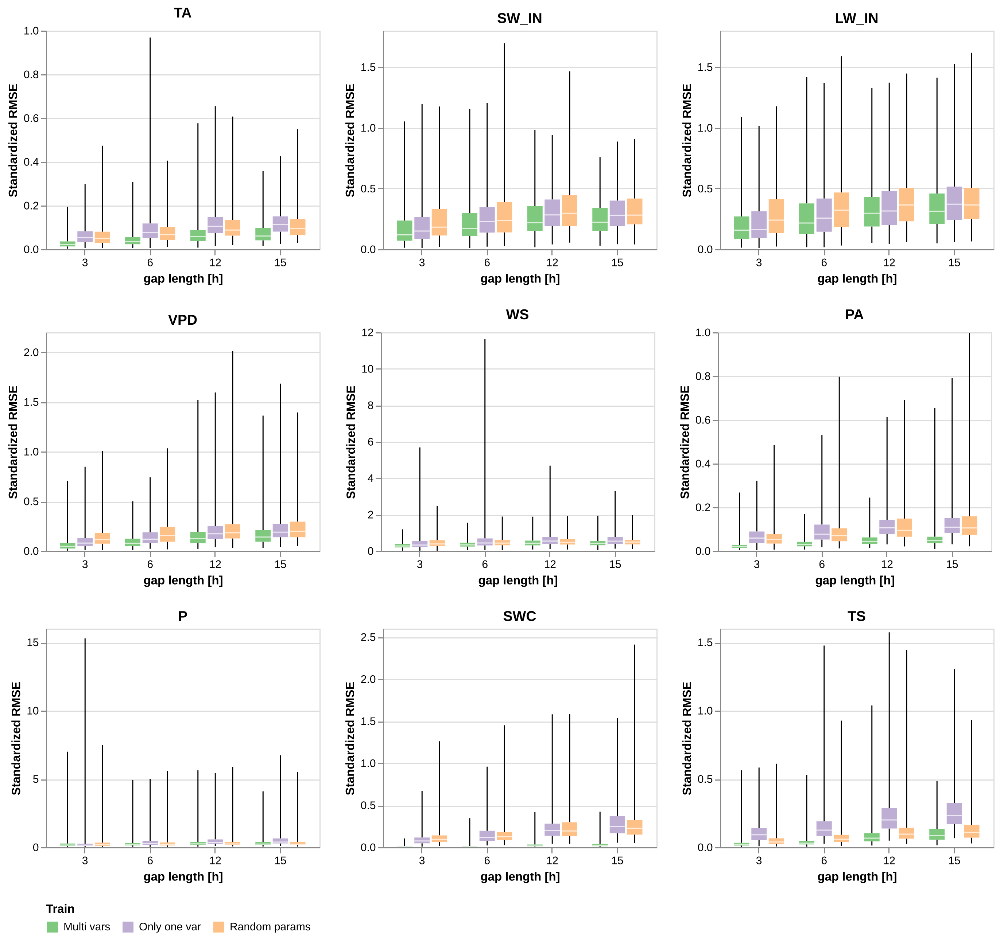

In [ ]:
p = plot_compare(res_train, "Train", scale_domain=["Multi vars", "Only one var", "Random params"])
save_plot(p, "train_compare")
show_plot("train_compare")

In [ ]:
t = table_compare3(res_train, 'Train')
table_compare3_latex(t, base_path_tbl / "train.tex", label="train_compare")
t

Train              Multi vars           Only one var           Random params  \
RMSE Standardized        mean       std         mean       std          mean   
Variable Gap [$h$]                                                             
TA       3.0         0.029316  0.024026     0.064266  0.045855      0.062565   
         6.0         0.047570  0.040525     0.095005  0.072717      0.086882   
         12.0        0.071804  0.058126     0.125767  0.083388      0.115255   
         15.0        0.074747  0.048259     0.126504  0.069100      0.115649   
SW_IN    3.0         0.189022  0.179283     0.210766  0.182537      0.255083   
         6.0         0.231952  0.183018     0.272504  0.184780      0.303011   
         12.0        0.273972  0.178823     0.313473  0.171075      0.345330   
         15.0        0.261540  0.147736     0.303385  0.147863      0.326338   
LW_IN    3.0         0.209100  0.174233     0.226141  0.186266      0.288581   
         6.0         0.271782  0.192016     0.304418  0.203732      0.355630   
         12.0        0.334969  0.205066     0.364683  0.217252      0.402762   
         15.0        0.349063  0.193528     0.402901  0.217125      0.399911   
VPD      3.0         0.066147  0.067398     0.103740  0.085860      0.151077   
         6.0         0.098182  0.074594     0.144168  0.093344      0.186584   
         12.0        0.158447  0.136362     0.211297  0.157147      0.228595   
         15.0        0.176550  0.133618     0.226348  0.142954      0.243083   
WS       3.0         0.304563  0.160289     0.499445  0.557471      0.460426   
         6.0         0.375432  0.197191     0.622664  0.840854      0.491942   
         12.0        0.475421  0.246422     0.682434  0.522670      0.543404   
         15.0        0.477836  0.250926     0.652838  0.402816      0.546776   
PA       3.0         0.023626  0.019933     0.070958  0.050700      0.062816   
         6.0         0.035030  0.020677     0.095294  0.067078      0.087910   
         12.0        0.050801  0.027830     0.125376  0.083567      0.116205   
         15.0        0.056982  0.043883     0.129951  0.086356      0.131319   
P        3.0         0.299489  0.556391     0.379744  1.156559      0.330911   
         6.0         0.349589  0.516015     0.457703  0.642463      0.385590   
         12.0        0.425566  0.605321     0.559601  0.644050      0.431093   
         15.0        0.423285  0.530192     0.625427  0.785776      0.441201   
SWC      3.0         0.010608  0.013968     0.094149  0.077060      0.117970   
         6.0         0.016923  0.028378     0.152065  0.116823      0.154318   
         12.0        0.029902  0.041090     0.243060  0.178547      0.243638   
         15.0        0.034230  0.043006     0.301561  0.194696      0.272256   
TS       3.0         0.029260  0.038676     0.111752  0.083746      0.054495   
         6.0         0.042557  0.045828     0.160466  0.147993      0.080075   
         12.0        0.089320  0.098119     0.235704  0.157743      0.127013   
         15.0        0.106004  0.070791     0.268831  0.154897      0.135304   

Train                         
RMSE Standardized        std  
Variable Gap [$h$]            
TA       3.0        0.050788  
         6.0        0.067355  
         12.0       0.089975  
         15.0       0.074126  
SW_IN    3.0        0.210510  
         6.0        0.230394  
         12.0       0.216703  
         15.0       0.168216  
LW_IN    3.0        0.198206  
         6.0        0.227813  
         12.0       0.234177  
         15.0       0.214815  
VPD      3.0        0.127722  
         6.0        0.134454  
         12.0       0.176609  
         15.0       0.161260  
WS       3.0        0.302247  
         6.0        0.269835  
         12.0       0.285233  
         15.0       0.292906  
PA       3.0        0.050095  
         6.0        0.071787  
         12.0       0.078518  
         15.0       0.102346  
P        3.0        0.554337  
         6.

## Fluxnet

In [ ]:
import polars as pl
from fastai.vision.data import get_grid

### Correlation

In [ ]:
import matplotlib.pyplot as plt

In [ ]:
import statsmodels.api as sm

In [ ]:
def auto_corr_df(data, nlags=96):
    autocorr = {}
    for col in data.columns:
        autocorr[col] = sm.tsa.acf(data[col], nlags=nlags)
    return pd.DataFrame(autocorr)

In [ ]:
auto_corr = auto_corr_df(hai).T[[1,3,6,12,24,48, 72, 96]]
auto_corr.columns = auto_corr.columns /2

In [ ]:
hai.corr().abs().mean()

TA       0.473646
SW_IN    0.302420
LW_IN    0.354683
VPD      0.416145
WS       0.195750
PA       0.222202
P        0.169337
SWC      0.313373
TS       0.465442
dtype: float64

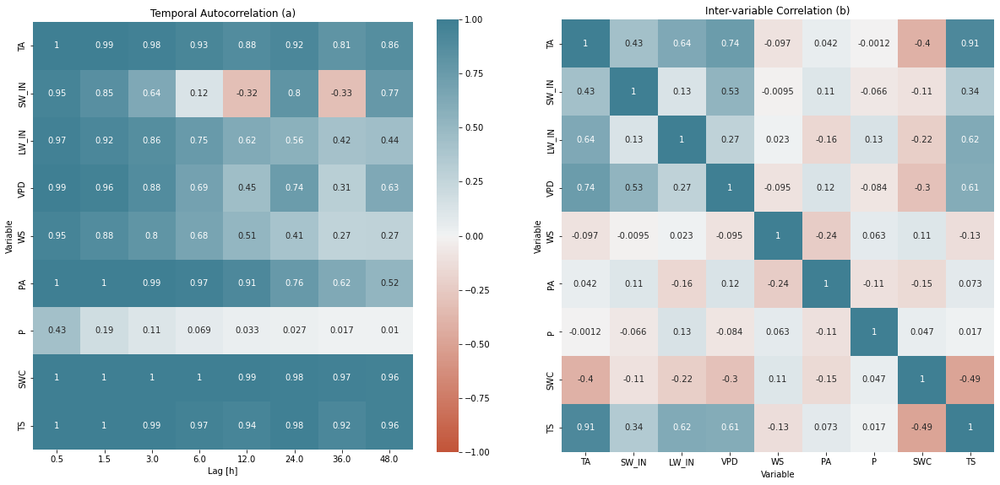

In [ ]:
axes = get_grid(2,1,2, figsize=(16.9,8))
sns.heatmap(hai.corr(), annot=True,     vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(20, 220, n=200), ax=axes[1], square=True, cbar=False)
sns.heatmap(auto_corr, annot=True,     vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(20, 220, n=200), square=True, ax=axes[0], cbar=True)
axes[0].set(ylabel="Variable", xlabel="Lag [h]", title="Temporal Autocorrelation (a)")
axes[1].set(xlabel="Variable", ylabel="Variable", title="Inter-variable Correlation (b)");
plt.tight_layout()
plt.savefig(base_path_img / "correlation.png")

### Gap distribution

In [ ]:
out_dir = here("../fluxnet/gap_stat")

In [ ]:
site_info = pl.read_parquet(out_dir / "../site_info.parquet").select([
    pl.col("start").cast(pl.Utf8).str.strptime(pl.Datetime, "%Y%m%d%H%M"),
    pl.col("end").cast(pl.Utf8).str.strptime(pl.Datetime, "%Y%m%d%H%M"),
    pl.col("site").cast(pl.Categorical).sort()
])

In [ ]:
def duration_n_obs(duration):
    "converts a duration into a n of fluxnet observations"
    return abs(int(duration.total_seconds() / (30 * 60)))

In [ ]:
files = out_dir.ls()
files.sort() # need to sort to match the site_info
sites = []
for i, path in enumerate(files):
    sites.append(pl.scan_parquet(path).with_columns([
        pl.lit(site_info[i, "site"]).alias("site"),
        pl.lit(duration_n_obs(site_info[i, "start"] -  site_info[i, "end"])).alias("total_obs"),
        pl.col("TIMESTAMP_END").cast(pl.Utf8).str.strptime(pl.Datetime, "%Y%m%d%H%M").alias("end"),
    ]).drop("TIMESTAMP_END"))

gap_stat = pl.concat(sites)

In [ ]:
pl.read_parquet(files[0])

TIMESTAMP_END,gap_len,variable
i64,u32,str
200901010030,16992,"""TA_F_MDS_QC"""
200912211100,5,"""TA_F_MDS_QC"""
200912211700,1,"""TA_F_MDS_QC"""
201001061300,1,"""TA_F_MDS_QC"""
201001071300,3,"""TA_F_MDS_QC"""
201001081130,2,"""TA_F_MDS_QC"""
201001081830,1,"""TA_F_MDS_QC"""
201001091000,2,"""TA_F_MDS_QC"""
201001191000,1,"""TA_F_MDS_QC"""


In [ ]:
gap_stat.head().collect()

gap_len,variable,site,total_obs,end
u32,str,str,i32,datetime[μs]
16992,"""TA_F_MDS_QC""","""AR-SLu""",52559,2009-01-01 00:30:00
5,"""TA_F_MDS_QC""","""AR-SLu""",52559,2009-12-21 11:00:00
1,"""TA_F_MDS_QC""","""AR-SLu""",52559,2009-12-21 17:00:00
1,"""TA_F_MDS_QC""","""AR-SLu""",52559,2010-01-06 13:00:00
3,"""TA_F_MDS_QC""","""AR-SLu""",52559,2010-01-07 13:00:00


In [ ]:
def plot_var_dist(var, small=False, ax=None):
    if ax is None: ax = get_grid(1)[0]
    ta_gaps = gap_stat.filter(
        (pl.col("variable") == var)
    ).filter(
        pl.col("gap_len") < 200 if small else True
    ).with_column(pl.col("gap_len") / (24 *2 * 7)).collect().to_pandas().hist("gap_len", bins=50, ax=ax)
    ax.set_title(f"{var} - { 'gaps < 200' if small else 'all gaps'}")
    if not small: ax.set_yscale('log')
    ax.set_xlabel("gap length (weeks)")
    ax.set_ylabel(f"{'Log' if not small else ''} n gaps")
    # plt.xscale('log') 

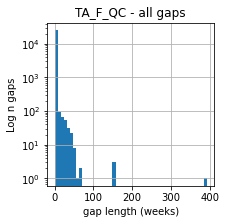

In [ ]:
plot_var_dist('TA_F_QC')

In [ ]:
color_map = dict(zip(scale_meteo.domain, list(sns.color_palette('Set2', n_colors=len(hai.columns)).as_hex())))

In [ ]:
qc_map = {
    'TA': 'TA_F_QC',
    'SW_IN': 'SW_IN_F_QC',
    'LW_IN': 'LW_IN_F_QC',
    'VPD': 'VPD_F_QC',
    'WS': 'WS_F_QC',
    'PA': 'PA_F_QC',
    'P': 'P_F_QC',
    'TS': 'TS_F_MDS_1_QC',
    'SWC': 'SWC_F_MDS_1_QC',
}

In [ ]:
def pl_in(col, values):
    expr = False
    for val in values:
        expr |= pl.col(col) == val
    return expr

In [ ]:
gap_stat.filter(pl_in('variable', qc_map.values())
               ).with_columns([
    pl.when(pl.col("gap_len") < 48*7).then(True).otherwise(False).alias("short"),
    pl.count().alias("total"),
    pl.count().alias("total len"),
]).groupby("short").agg([
    (pl.col("gap_len").count() / pl.col("total")).alias("frac_num"),
    (pl.col("gap_len").sum() / pl.col("total len")).alias("frac_len")
]).collect()

short,frac_num,frac_len
bool,list[f64],list[f64]
false,"[0.010775, 0.010775, ... 0.010775]","[63.844386, 63.844386, ... 63.844386]"
true,"[0.989225, 0.989225, ... 0.989225]","[7.261655, 7.261655, ... 7.261655]"


In [ ]:
gap_stat.filter(pl_in('variable', qc_map.values())
               ).with_columns([
    pl.when(pl.col("gap_len") < 48*7).then(True).otherwise(False).alias("short"),
    pl.count().alias("total"),
    pl.count().alias("total len"),
]).groupby("short").agg([
    (pl.col("gap_len").count() / pl.col("total")).alias("frac_num"),
    (pl.col("gap_len").sum() / pl.col("total len")).alias("frac_len")
]).collect()

short,frac_num,frac_len
bool,list[f64],list[f64]
false,"[0.010775, 0.010775, ... 0.010775]","[63.844386, 63.844386, ... 63.844386]"
true,"[0.989225, 0.989225, ... 0.989225]","[7.261655, 7.261655, ... 7.261655]"


In [ ]:
frac_miss = gap_stat.filter(
    pl_in('variable', qc_map.values())
).groupby(["site", "variable"]).agg([
    pl.col("gap_len").mean().alias("mean"),
    (pl.col("gap_len").sum() / pl.col("total_obs").first()).alias("frac_gap")
])

In [ ]:
frac_miss.groupby('variable').agg([
    pl.col("frac_gap").max().alias("max"),
    pl.col("frac_gap").min().alias("min"),
    pl.col("frac_gap").std().alias("std"),
    pl.col("frac_gap").mean().alias("mean"),
]).collect()

variable,max,min,std,mean
str,f64,f64,f64,f64
"""P_F_QC""",1.503296,0.000011,0.330422,0.311598
"""SWC_F_MDS_1_QC...",1.487143,0.000011,0.29985,0.314847
"""SW_IN_F_QC""",2.193984,0.000038,0.21952,0.16772
"""TS_F_MDS_1_QC""",3.090642,0.000011,0.38542,0.282106
"""VPD_F_QC""",2.298799,0.000011,0.297668,0.245457
"""TA_F_QC""",2.299027,0.000011,0.256043,0.198846
"""WS_F_QC""",2.675324,0.000798,0.323944,0.257303
"""LW_IN_F_QC""",7.074603,0.000019,0.704469,0.578246
"""PA_F_QC""",2.675381,0.000011,0.420542,0.387658


In [ ]:
frac_miss.sort("frac_gap", reverse=True).collect()

site,variable,mean,frac_gap
str,str,f64,f64
"""US-LWW""","""LW_IN_F_QC""",11267.590909,7.074603
"""US-Wi5""","""LW_IN_F_QC""",70128.0,3.992031
"""ES-LgS""","""LW_IN_F_QC""",175344.0,3.333093
"""US-LWW""","""TS_F_MDS_1_QC""",1320.646341,3.090642
"""US-Wi5""","""TS_F_MDS_1_QC""",62.142857,2.897194
"""US-Wi0""","""LW_IN_F_QC""",1369.694444,2.814601
"""US-ORv""","""PA_F_QC""",3.899334,2.675381
"""US-ORv""","""WS_F_QC""",3.899251,2.675324
"""US-LWW""","""PA_F_QC""",409.701754,2.665944


In [ ]:
site_info.filter((pl.col("site") == "US-LWW"))

start,end,site
datetime[μs],datetime[μs],cat
1997-01-01 00:30:00,1999-01-01 00:00:00,"""US-LWW"""


In [ ]:
246556

In [ ]:
gap_stat.filter((pl.col("site") == "US-LWW") & (pl.col("variable") == "LW_IN_F_QC" )).collect()

gap_len,variable,site,total_obs,end
u32,str,str,i32,datetime[μs]
246556,"""LW_IN_F_QC""","""US-LWW""",35039,2000-01-01 00:30:00
19,"""LW_IN_F_QC""","""US-LWW""",35039,2014-02-11 08:30:00
6,"""LW_IN_F_QC""","""US-LWW""",35039,2014-03-08 08:00:00
1,"""LW_IN_F_QC""","""US-LWW""",35039,2014-03-08 11:30:00
1,"""LW_IN_F_QC""","""US-LWW""",35039,2014-03-08 13:00:00
50,"""LW_IN_F_QC""","""US-LWW""",35039,2014-11-18 13:00:00
21,"""LW_IN_F_QC""","""US-LWW""",35039,2014-11-19 22:30:00
22,"""LW_IN_F_QC""","""US-LWW""",35039,2014-11-24 23:30:00
55,"""LW_IN_F_QC""","""US-LWW""",35039,2014-11-26 06:30:00


In [ ]:
def plot_var_dist_small(var, ax=None, small=True):
    if ax is None: ax = get_grid(1)[0]
    
    color = color_map[var]
    var_qc = qc_map[var]
    ta_gaps = gap_stat.filter(
        (pl.col("variable") == var_qc)
    ).filter(
        pl.col("gap_len") < (24 * 2 *7) if small else True 
    ).with_column(pl.col("gap_len") / (2 if small else 48 * 7)
                 ).collect().to_pandas().hist("gap_len", bins=50, ax=ax, edgecolor="white", color=color)
    ax.set_title(f"{var} - { 'gap length <  1 week' if small else 'all gaps'}")
    ax.set_xlabel(f"gap length ({ 'hour' if small else 'week'})")
    ax.set_ylabel(f"Log n gaps")
    ax.set_yscale('log') 

In [ ]:
vars = gap_stat.select(pl.col("variable").unique()).collect()

In [ ]:
vars.filter(pl.col("variable").str.contains("TA"))

In [ ]:
for ax, var in zip(get_grid(9,3,3, figsize=(15,12), sharey=False), list(var_type.categories)):
    plot_var_dist_small(var, ax=ax)
plt.savefig(base_path_img / "gap_len_dist_small.png")

In [ ]:
for ax, var in zip(get_grid(9,3,3, figsize=(15,12), sharey=False), list(var_type.categories)):
    plot_var_dist_small(var, ax=ax, small=False)
plt.savefig(base_path_img / "gap_len_dist.png")

methods colors

In [ ]:
print(sns.color_palette('Dark2').as_hex())